<a href="https://colab.research.google.com/github/mvaraujo/GoogleColab/blob/master/Aula_08_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##### Copyright 2019 The TensorFlow Authors.

# Rede Adversarial Gerativa Convolucional Profunda

## O que são GANs?
[Redes Adversariais Generativas](https://arxiv.org/abs/1406.2661) (GANs) são uma das ideias mais interessantes da ciência da computação hoje. Dois modelos são treinados simultaneamente por um processo adversarial. Um gerador ("o artista") aprende a criar imagens que parecem reais, enquanto um discriminador ("o crítico de arte") aprende a distinguir imagens reais de falsificações.

![A diagram of a generator and discriminator](https://github.com/tensorflow/docs/blob/master/site/en/tutorials/generative/images/gan1.png?raw=1)

Durante o treinamento, o gerador torna-se progressivamente melhor na criação de imagens que parecem reais, enquanto o discriminador torna-se melhor em diferenciá-las. O processo atinge o equilíbrio quando o discriminador não consegue mais distinguir imagens reais de falsificações.

![A second diagram of a generator and discriminator](https://github.com/tensorflow/docs/blob/master/site/en/tutorials/generative/images/gan2.png?raw=1)

Este bloco de notas demonstra esse processo no conjunto de dados MNIST. A animação a seguir mostra uma série de imagens produzidas pelo gerador conforme foi treinado por 50 épocas. As imagens começam como ruído aleatório e cada vez mais se assemelham a dígitos escritos à mão com o tempo.

![sample output](https://tensorflow.org/images/gan/dcgan.gif)

O curso do MIT detalha em profundidade estas redes: [Intro to Deep Learning](http://introtodeeplearning.com/).

### Importação de Bibliotecas

In [2]:
import tensorflow as tf

In [3]:
tf.__version__

'2.6.0'

In [4]:
# To generate GIFs
!pip install imageio
!pip install git+https://github.com/tensorflow/docs

  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-l29jhe4r
  Running command git clone -q https://github.com/tensorflow/docs /tmp/pip-req-build-l29jhe4r
  Created wheel for tensorflow-docs: filename=tensorflow_docs-0.0.0.dev0-py3-none-any.whl size=157855 sha256=4b9cd15dff36a684db3d49249cb13db30005ad156199173ae2f6899d976fbaa9
  Stored in directory: /tmp/pip-ephem-wheel-cache-5z32li48/wheels/cc/c4/d8/5341e93b6376c5c929c49469fce21155eb69cef1a4da4ce32c
Successfully built tensorflow-docs


In [16]:
import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
from tensorflow.keras import layers
import time

from IPython import display

### MNIST Dataset

Utilizaremos o conjunto de dados MNIST para treinar o gerador e o discriminador. O gerador irá gerar dígitos manuscritos semelhantes aos dados MNIST.



In [7]:
(train_images, train_labels), (_, _) = tf.keras.datasets.mnist.load_data()

In [8]:
train_images = train_images.reshape(train_images.shape[0], 28, 28, 1).astype('float32')
train_images = (train_images - 127.5) / 127.5  # Normalize the images to [-1, 1]

In [9]:
BUFFER_SIZE = 60000
BATCH_SIZE = 256

In [10]:
# Batch and shuffle the data
train_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

### Generator Model

O gerador usa camadas tf.keras.layers.Conv2DTranspose (upsampling) para produzir uma imagem a partir de um ruído aleatório. Uma camada densa recebe esse ruído como entrada e, em seguida, faz upsample inúmeras vezes até atingir o tamanho de imagem desejado de 28x28x1. 

In [14]:
def make_generator_model():
    model = tf.keras.Sequential()
    model.add(layers.Dense(7*7*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Reshape((7, 7, 256)))
    assert model.output_shape == (None, 7, 7, 256)  # Note: None is the batch size

    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
    assert model.output_shape == (None, 7, 7, 128)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 14, 14, 64)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    assert model.output_shape == (None, 28, 28, 1)

    return model

In [15]:
layers

NameError: ignored

Vamos gerar uma imagem de exemplo (ainda não treinado

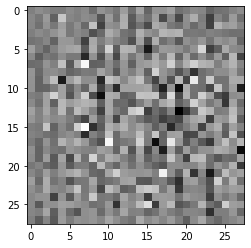

In [18]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

###  Discriminator

Classificador baseado em uma CNN

In [19]:
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                                     input_shape=[28, 28, 1]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Flatten())
    model.add(layers.Dense(1))

    return model

Use o discriminador (ainda não treinado) para classificar as imagens geradas como reais ou falsas. O modelo será treinado para gerar valores positivos para imagens reais e valores negativos para imagens falsas.




In [20]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print (decision)

tf.Tensor([[0.00333086]], shape=(1, 1), dtype=float32)


## Loss e Otimização

Define loss functions and optimizers for both models.


In [ ]:
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

### Discriminator loss

Este método quantifica o quão bem o discriminador é capaz de distinguir imagens reais de falsificações. Ele compara as previsões do discriminador em imagens reais a uma matriz de 1s e as previsões do discriminador em imagens falsas (geradas) a uma matriz de 0s.

In [ ]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

### Generator loss
A perda do gerador quantifica o quão bem ele foi capaz de enganar o discriminador. Intuitivamente, se o gerador estiver funcionando bem, o discriminador classificará as imagens falsas como reais (ou 1). Aqui, compare as decisões dos discriminadores nas imagens geradas a uma matriz de 1s.

In [ ]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

The discriminator and the generator optimizers are different since you will train two networks separately.

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

### Checkpoints
Definimos como salvar parcialmente os pesos do treinamento

In [ ]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

## Rotina de Treinamento


In [ ]:
EPOCHS = 600
noise_dim = 100
num_examples_to_generate = 16

#Fixo o seed para gerar sempre o mesmo ruído
#Apenas para visualizar a evolucao da rede (gif)
seed = tf.random.normal([num_examples_to_generate, noise_dim])

O loop de treinamento começa com o gerador recebendo uma semente aleatória como entrada. Essa semente é usada para produzir uma imagem. O discriminador é então usado para classificar imagens reais (retiradas do conjunto de treinamento) e imagens falsas (produzidas pelo gerador). A perda é calculada para cada um desses modelos, e os gradientes são usados ​​para atualizar o gerador e o discriminador.

In [ ]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      generated_images = generator(noise, training=True)

      real_output = discriminator(images, training=True)
      fake_output = discriminator(generated_images, training=True)

      gen_loss = generator_loss(fake_output)
      disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

In [ ]:
def train(dataset, epochs):
  for epoch in range(epochs):
    start = time.time()

    for image_batch in dataset:
      train_step(image_batch)

    # Produce images for the GIF as you go
    display.clear_output(wait=True)
    generate_and_save_images(generator,
                             epoch + 1,
                             seed)

    # Save the model every 15 epochs
    if (epoch + 1) % 15 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  # Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator,
                           epochs,
                           seed)

**Gerar e salvar imagens

**


In [ ]:
def generate_and_save_images(model, epoch, test_input):
  # Notice `training` is set to False.
  # This is so all layers run in inference mode (batchnorm).
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
      plt.subplot(4, 4, i+1)
      plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
      plt.axis('off')

  plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

## Treinamento
Chame o método train() definido acima para treinar o gerador e o discriminador simultaneamente. Observe que treinar GANs pode ser complicado. É importante que o gerador e o discriminador não se sobreponham (por exemplo, que treinem a uma taxa semelhante).

No início do treinamento, as imagens geradas parecem ruídos aleatórios. Conforme o treinamento avança, os dígitos gerados parecerão cada vez mais reais. Após cerca de 50 épocas, eles se assemelham aos dígitos MNIST. Isso pode levar cerca de um minuto / período com as configurações padrão do Colab.**negrito**

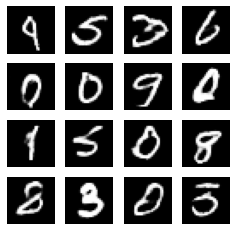

In [ ]:
train(train_dataset, EPOCHS)

Exemplo de como restaurar um modelo pré-treinado

In [ ]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

## Create a GIF


In [ ]:
# Display a single image using the epoch number
def display_image(epoch_no):
  return PIL.Image.open('image_at_epoch_{:04d}.png'.format(epoch_no))

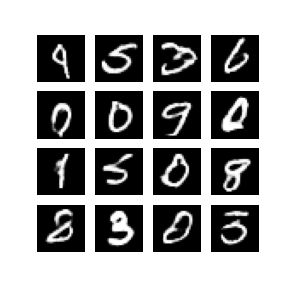

In [ ]:
display_image(EPOCHS)

Use o imageio para criar um GIF animado usando as imagens salvas durante o treinamento.



In [ ]:
anim_file = 'dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)


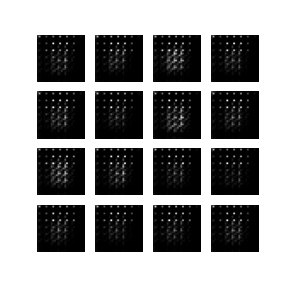

In [ ]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)